In [47]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [48]:
# the goal is to find the probability of

# condition:
# left_neural_foraminal_narrowing
# right_neural_foraminal_narrowing
# left_subarticular_stenosis
# right_subarticular_stenosis
# spinal_canal_stenosis

# at each spinal level:
# l1_l2, l2_l3, l3_l4, l4_l5, l5_s1

# in terms of degree:
# normal_mild, moderate, severe

- neural foraminal narrowing. where nerves leave spinal cord.
- subarticular stenosis. stenosis = narrowing. narrowing of the lateral recess. located just below facet joint.
- spinal canal stenosis.

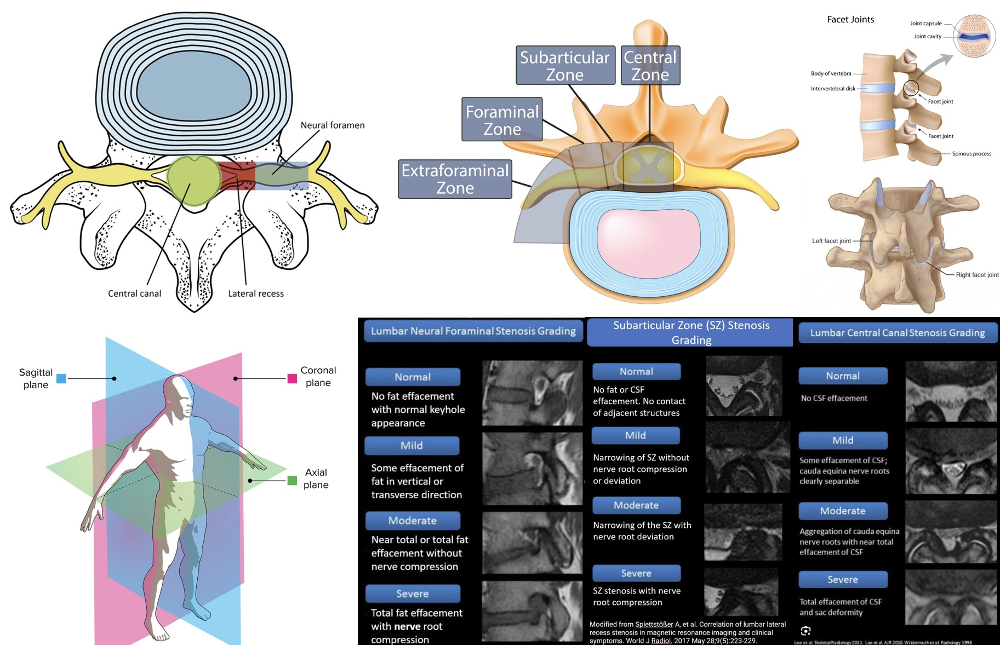

In [49]:
from IPython.display import Image, display
img_path = '/content/drive/My Drive/Kaggle/rsna-2024-lsdc-train/lsdc_info.jpg'
display(Image(filename=img_path))

MRI imaging variants
* T1 weighted: fat is brighter. inner part of bones appears brighter.
* T2 weighted: water is brighter. spinal canal appears brighter.


varaints in this dataset
* Axial T2
* Sagittal T1
* Sagittal T2/STIR: fat-suppressed. suppresses the bright fat signal.

```
.
└── /kaggle/input/rsna-2024-lumbar-spine-degenerative-classification/
    ├── test_images/
    │   ├── 44036939/
    │   │   └── 2828203845/
    │   │       ├── 1.dcm
    │   │       └── ...
    │   └── ...
    ├── test_series_descriptions.csv
    ├── train_images/
    │   ├── 4003253/
    │   │   └── 702807833/
    │   │       ├── 1.dcm
    │   │       └── ...
    │   └── ...
    ├── train_label_coordinates.csv
    ├── train_series_descriptions.csv
    └── train.csv
```

In [50]:
!pip install -q pydicom

In [42]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from matplotlib.patches import Circle
import pydicom
import os
import glob
import cv2
from tqdm import tqdm
import re
from pathlib import Path
import shutil


In [43]:
# INPUT_PATH  = '/kaggle/input/rsna-2024-lumbar-spine-degenerative-classification'
# INPUT_PATH  = '/content/drive/MyDrive/Kaggle/rsna-2024-lumbar-spine-degenerative-classification'
INPUT_PATH  = '/Users/star-bits/Downloads/rsna-2024-lumbar-spine-degenerative-classification'
# OUTPUT_PATH = '/kaggle/working'
# OUTPUT_PATH = '/content/drive/MyDrive/Kaggle/rsna-2024-lsdc-train'
OUTPUT_PATH = '/Users/star-bits/Downloads/rsna-2024-lsdc-train'

In [44]:
# train_label_coordinates.csv --> xy coordinates with image number
# train_series_descriptions.csv --> imaging types
# train.csv --> severity in 25 channels

train_df = pd.read_csv(f'{INPUT_PATH}/train.csv')
desc_df  = pd.read_csv(f'{INPUT_PATH}/train_series_descriptions.csv')
coord_df = pd.read_csv(f'{INPUT_PATH}/train_label_coordinates.csv')

In [45]:
train_df.head()

,study_id,spinal_canal_stenosis_l1_l2,spinal_canal_stenosis_l2_l3,spinal_canal_stenosis_l3_l4,spinal_canal_stenosis_l4_l5,spinal_canal_stenosis_l5_s1,left_neural_foraminal_narrowing_l1_l2,left_neural_foraminal_narrowing_l2_l3,left_neural_foraminal_narrowing_l3_l4,left_neural_foraminal_narrowing_l4_l5,...,left_subarticular_stenosis_l1_l2,left_subarticular_stenosis_l2_l3,left_subarticular_stenosis_l3_l4,left_subarticular_stenosis_l4_l5,left_subarticular_stenosis_l5_s1,right_subarticular_stenosis_l1_l2,right_subarticular_stenosis_l2_l3,right_subarticular_stenosis_l3_l4,right_subarticular_stenosis_l4_l5,right_subarticular_stenosis_l5_s1
0,4003253,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,...,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild
1,4646740,Normal/Mild,Normal/Mild,Moderate,Severe,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,...,Normal/Mild,Normal/Mild,Normal/Mild,Severe,Normal/Mild,Normal/Mild,Moderate,Moderate,Moderate,Normal/Mild
2,7143189,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,...,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild
3,8785691,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,...,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild
4,10728036,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,...,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild


In [46]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1975 entries, 0 to 1974
Data columns (total 26 columns):
 #   Column                                  Non-Null Count  Dtype 
---  ------                                  --------------  ----- 
 0   study_id                                1975 non-null   int64 
 1   spinal_canal_stenosis_l1_l2             1974 non-null   object
 2   spinal_canal_stenosis_l2_l3             1974 non-null   object
 3   spinal_canal_stenosis_l3_l4             1974 non-null   object
 4   spinal_canal_stenosis_l4_l5             1974 non-null   object
 5   spinal_canal_stenosis_l5_s1             1974 non-null   object
 6   left_neural_foraminal_narrowing_l1_l2   1973 non-null   object
 7   left_neural_foraminal_narrowing_l2_l3   1973 non-null   object
 8   left_neural_foraminal_narrowing_l3_l4   1973 non-null   object
 9   left_neural_foraminal_narrowing_l4_l5   1973 non-null   object
 10  left_neural_foraminal_narrowing_l5_s1   1973 non-null   object
 11  righ

In [47]:
null_counts = train_df.isnull().sum()
for column, count in null_counts.items():
    print(f"{column}: {count}")

study_id: 0
spinal_canal_stenosis_l1_l2: 1
spinal_canal_stenosis_l2_l3: 1
spinal_canal_stenosis_l3_l4: 1
spinal_canal_stenosis_l4_l5: 1
spinal_canal_stenosis_l5_s1: 1
left_neural_foraminal_narrowing_l1_l2: 2
left_neural_foraminal_narrowing_l2_l3: 2
left_neural_foraminal_narrowing_l3_l4: 2
left_neural_foraminal_narrowing_l4_l5: 2
left_neural_foraminal_narrowing_l5_s1: 2
right_neural_foraminal_narrowing_l1_l2: 8
right_neural_foraminal_narrowing_l2_l3: 8
right_neural_foraminal_narrowing_l3_l4: 8
right_neural_foraminal_narrowing_l4_l5: 8
right_neural_foraminal_narrowing_l5_s1: 8
left_subarticular_stenosis_l1_l2: 164
left_subarticular_stenosis_l2_l3: 82
left_subarticular_stenosis_l3_l4: 3
left_subarticular_stenosis_l4_l5: 3
left_subarticular_stenosis_l5_s1: 11
right_subarticular_stenosis_l1_l2: 161
right_subarticular_stenosis_l2_l3: 82
right_subarticular_stenosis_l3_l4: 2
right_subarticular_stenosis_l4_l5: 2
right_subarticular_stenosis_l5_s1: 7


In [48]:
for column in train_df.columns:
    print(f"{column}: {train_df[column].unique()}")

study_id: [   4003253    4646740    7143189 ... 4284048608 4287160193 4290709089]
spinal_canal_stenosis_l1_l2: ['Normal/Mild' 'Moderate' 'Severe' nan]
spinal_canal_stenosis_l2_l3: ['Normal/Mild' 'Moderate' 'Severe' nan]
spinal_canal_stenosis_l3_l4: ['Normal/Mild' 'Moderate' 'Severe' nan]
spinal_canal_stenosis_l4_l5: ['Normal/Mild' 'Severe' 'Moderate' nan]
spinal_canal_stenosis_l5_s1: ['Normal/Mild' 'Moderate' 'Severe' nan]
left_neural_foraminal_narrowing_l1_l2: ['Normal/Mild' 'Moderate' 'Severe' nan]
left_neural_foraminal_narrowing_l2_l3: ['Normal/Mild' 'Moderate' 'Severe' nan]
left_neural_foraminal_narrowing_l3_l4: ['Normal/Mild' 'Moderate' 'Severe' nan]
left_neural_foraminal_narrowing_l4_l5: ['Moderate' 'Normal/Mild' 'Severe' nan]
left_neural_foraminal_narrowing_l5_s1: ['Normal/Mild' 'Moderate' 'Severe' nan]
right_neural_foraminal_narrowing_l1_l2: ['Normal/Mild' 'Severe' 'Moderate' nan]
right_neural_foraminal_narrowing_l2_l3: ['Normal/Mild' 'Moderate' 'Severe' nan]
right_neural_foram

In [49]:
desc_df.head()

,study_id,series_id,series_description
0,4003253,702807833,Sagittal T2/STIR
1,4003253,1054713880,Sagittal T1
2,4003253,2448190387,Axial T2
3,4646740,3201256954,Axial T2
4,4646740,3486248476,Sagittal T1


In [50]:
desc_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6294 entries, 0 to 6293
Data columns (total 3 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   study_id            6294 non-null   int64 
 1   series_id           6294 non-null   int64 
 2   series_description  6294 non-null   object
dtypes: int64(2), object(1)
memory usage: 147.6+ KB


In [51]:
null_counts = desc_df.isnull().sum()
for column, count in null_counts.items():
    print(f"{column}: {count}")

study_id: 0
series_id: 0
series_description: 0


In [52]:
for column in desc_df.columns:
    print(f"{column}: {desc_df[column].unique()}")

study_id: [   4003253    4646740    7143189 ... 4284048608 4287160193 4290709089]
series_id: [ 702807833 1054713880 2448190387 ... 3274612423 3390218084 4237840455]
series_description: ['Sagittal T2/STIR' 'Sagittal T1' 'Axial T2']


In [53]:
coord_df.head()

,study_id,series_id,instance_number,condition,level,x,y
0,4003253,702807833,8,Spinal Canal Stenosis,L1/L2,322.831858,227.964602
1,4003253,702807833,8,Spinal Canal Stenosis,L2/L3,320.571429,295.714286
2,4003253,702807833,8,Spinal Canal Stenosis,L3/L4,323.030303,371.818182
3,4003253,702807833,8,Spinal Canal Stenosis,L4/L5,335.292035,427.327434
4,4003253,702807833,8,Spinal Canal Stenosis,L5/S1,353.415929,483.964602


In [54]:
coord_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48692 entries, 0 to 48691
Data columns (total 7 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   study_id         48692 non-null  int64  
 1   series_id        48692 non-null  int64  
 2   instance_number  48692 non-null  int64  
 3   condition        48692 non-null  object 
 4   level            48692 non-null  object 
 5   x                48692 non-null  float64
 6   y                48692 non-null  float64
dtypes: float64(2), int64(3), object(2)
memory usage: 2.6+ MB


In [55]:
# 각 스터디의 시리즈가 몇개?

series_counts = desc_df.groupby('study_id')['series_id'].count()
print(f"Min series per study: {series_counts.min()}")
print(f"Max series per study: {series_counts.max()}")

Min series per study: 2
Max series per study: 6


In [56]:
print(desc_df['series_description'].value_counts())

series_description
Axial T2            2340
Sagittal T1         1980
Sagittal T2/STIR    1974
Name: count, dtype: int64


In [57]:
# 각 스터디에 a1, s1, s2가 다 있는지?

def count_series(group):
    return pd.Series({
        'Axial T2': (group['series_description'] == 'Axial T2').sum(),
        'Sagittal T1': (group['series_description'] == 'Sagittal T1').sum(),
        'Sagittal T2/STIR': (group['series_description'] == 'Sagittal T2/STIR').sum()
    })

# Group by study_id and count the series
series_counts = desc_df.groupby('study_id').apply(count_series)

# Function to check if a row is not [1, 1, 1]
def is_not_111(row):
    return (row != 1).any()

# Filter for rows that are not [1, 1, 1]
non_111_counts = series_counts[series_counts.apply(is_not_111, axis=1)]

# Print the results
print("Cases where the count for the series isn't [1, 1, 1]:")
for study_id, row in non_111_counts.iterrows():
    print(f"Study ID: {study_id}")
    print(f"Count: [{row['Axial T2']}, {row['Sagittal T1']}, {row['Sagittal T2/STIR']}]")
    print()  # Empty line for better readability

# Print summary
print(f"Total number of studies: {len(series_counts)}")
print(f"Number of studies with counts not equal to [1, 1, 1]: {len(non_111_counts)}")
print(f"Percentage of studies with irregular counts: {len(non_111_counts) / len(series_counts) * 100:.2f}%")

# Additional output for studies where Sagittal T1 and Sagittal T2/STIR counts are not 1
print("\nStudy IDs where Sagittal T1 and Sagittal T2/STIR counts are not 1:")
for study_id, row in series_counts.iterrows():
    if row['Sagittal T1'] != 1 or row['Sagittal T2/STIR'] != 1:
        print(f"Study ID: {study_id}")
        print(f"Sagittal T1 count: {row['Sagittal T1']}")
        print(f"Sagittal T2/STIR count: {row['Sagittal T2/STIR']}")
        print()  # Empty line for better readability

Cases where the count for the series isn't [1, 1, 1]:
Study ID: 10728036
Count: [2, 1, 1]

Study ID: 11943292
Count: [2, 1, 1]

Study ID: 26342422
Count: [2, 1, 1]

Study ID: 29931867
Count: [2, 1, 1]

Study ID: 44060036
Count: [2, 1, 1]

Study ID: 52695609
Count: [2, 1, 1]

Study ID: 63725508
Count: [2, 1, 1]

Study ID: 85480902
Count: [2, 1, 1]

Study ID: 87937369
Count: [2, 1, 1]

Study ID: 105895264
Count: [2, 1, 1]

Study ID: 108348787
Count: [2, 1, 1]

Study ID: 109454808
Count: [3, 1, 1]

Study ID: 109677683
Count: [2, 1, 1]

Study ID: 113121178
Count: [2, 1, 1]

Study ID: 169651375
Count: [2, 1, 1]

Study ID: 178041181
Count: [3, 1, 1]

Study ID: 183230492
Count: [2, 1, 1]

Study ID: 209512460
Count: [2, 1, 1]

Study ID: 211314658
Count: [2, 1, 1]

Study ID: 215111925
Count: [2, 1, 1]

Study ID: 215149692
Count: [3, 1, 1]

Study ID: 228290246
Count: [2, 1, 1]

Study ID: 258027917
Count: [2, 1, 1]

Study ID: 259346069
Count: [2, 1, 1]

Study ID: 267842058
Count: [3, 1, 1]

Study

/var/folders/x2/tpkrd9fs0mz2qrfzz7wpj7x00000gn/T/ipykernel_14317/2107106159.py:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  series_counts = desc_df.groupby('study_id').apply(count_series)


In [58]:
desc_df[desc_df['study_id']==4096820034]

,study_id,series_id,series_description
5997,4096820034,300517765,Axial T2
5998,4096820034,2097107888,Axial T2
5999,4096820034,2602265508,Sagittal T2/STIR
6000,4096820034,2679683906,Axial T2
6001,4096820034,3114813181,Axial T2
6002,4096820034,3236751045,Sagittal T1


In [59]:
coord_df[coord_df['study_id']==4096820034]

,study_id,series_id,instance_number,condition,level,x,y
46392,4096820034,300517765,5,Right Subarticular Stenosis,L4/L5,305.500000,372.444444
46393,4096820034,300517765,11,Right Subarticular Stenosis,L5/S1,298.388889,358.222222
46394,4096820034,2097107888,10,Left Subarticular Stenosis,L1/L2,348.379062,378.070442
46395,4096820034,2097107888,16,Left Subarticular Stenosis,L2/L3,344.193491,369.699299
46396,4096820034,2097107888,22,Left Subarticular Stenosis,L3/L4,342.100705,359.235371
46397,4096820034,2602265508,7,Spinal Canal Stenosis,L1/L2,268.706316,88.525822
46398,4096820034,2602265508,7,Spinal Canal Stenosis,L2/L3,257.288476,135.399061
46399,4096820034,2602265508,7,Spinal Canal Stenosis,L3/L4,247.673452,180.469484
46400,4096820034,2602265508,7,Spinal Canal Stenosis,L4/L5,244.668757,220.732394
46401,4096820034,2602265508,7,Spinal Canal Stenosis,L5/S1,253.081903,260.394366


In [60]:
# A2, S1, S2는 각각 어느 질환을 판별하는데 사용되는지?

# Axial T2 --> Left/Right Subarticular Stenosis
# Sagittal T1 --> Left/Right Neural Foraminal Narrowing
# Sagittal T2/STIR --> Spinal Canal Stenosis
# 맞나? (맞다.)

In [61]:
def get_unique_condition(conditions):
    # Remove 'Left' and 'Right' from conditions and get unique values
    return set(cond.replace('Left ', '').replace('Right ', '') for cond in conditions)

def print_series_info(desc_df, coord_df, start=0, end=None):
    # Get unique study_ids and sort them
    study_ids = sorted(desc_df['study_id'].unique())

    # Select the range of study_ids to process
    selected_study_ids = study_ids[start:end]

    # Filter desc_df and coord_df to include only the selected study_ids
    desc_df_filtered = desc_df[desc_df['study_id'].isin(selected_study_ids)]
    coord_df_filtered = coord_df[coord_df['study_id'].isin(selected_study_ids)]

    # Group coord_df by study_id and series_id
    grouped_coord = coord_df_filtered.groupby(['study_id', 'series_id'])

    # Iterate through each study_id in the filtered desc_df
    for study_id, study_group in desc_df_filtered.groupby('study_id'):
        print(f"Study ID: {study_id}")

        # Iterate through each series_id in the study group
        for _, row in study_group.iterrows():
            series_id = row['series_id']
            series_description = row['series_description']

            # Get conditions for this series_id from coord_df
            if (study_id, series_id) in grouped_coord.groups:
                conditions = grouped_coord.get_group((study_id, series_id))['condition']
                unique_conditions = get_unique_condition(conditions)
                conditions_str = ', '.join(unique_conditions)
            else:
                conditions_str = "No conditions found"

            print(f"  Series ID: {series_id}")
            print(f"    Description: {series_description}")
            print(f"    Conditions: {conditions_str}")

        print()  # Empty line between studies

# Run the function for the first 100 studies
print_series_info(desc_df, coord_df, start=0, end=10)

Study ID: 4003253
  Series ID: 702807833
    Description: Sagittal T2/STIR
    Conditions: Spinal Canal Stenosis
  Series ID: 1054713880
    Description: Sagittal T1
    Conditions: Neural Foraminal Narrowing
  Series ID: 2448190387
    Description: Axial T2
    Conditions: Subarticular Stenosis

Study ID: 4646740
  Series ID: 3201256954
    Description: Axial T2
    Conditions: Subarticular Stenosis
  Series ID: 3486248476
    Description: Sagittal T1
    Conditions: Neural Foraminal Narrowing
  Series ID: 3666319702
    Description: Sagittal T2/STIR
    Conditions: Spinal Canal Stenosis

Study ID: 7143189
  Series ID: 132939515
    Description: Sagittal T2/STIR
    Conditions: Spinal Canal Stenosis
  Series ID: 1951927562
    Description: Axial T2
    Conditions: Subarticular Stenosis
  Series ID: 3219733239
    Description: Sagittal T1
    Conditions: Neural Foraminal Narrowing

Study ID: 8785691
  Series ID: 481125819
    Description: Sagittal T2/STIR
    Conditions: Spinal Canal S

In [62]:
def check_pattern(series_description, condition):
    if series_description == 'Axial T2':
        return 'Subarticular Stenosis' in condition
    elif series_description == 'Sagittal T1':
        return 'Neural Foraminal Narrowing' in condition
    elif series_description == 'Sagittal T2/STIR':
        return condition == 'Spinal Canal Stenosis'
    return False  # For any other series_description

def print_mismatches(desc_df, coord_df):
    # Create a dictionary for faster lookup in coord_df
    coord_dict = coord_df.groupby(['study_id', 'series_id'])['condition'].apply(list).to_dict()

    mismatches_found = False

    for _, row in desc_df.iterrows():
        study_id = row['study_id']
        series_id = row['series_id']
        series_description = row['series_description']

        # Look up conditions in coord_df
        conditions = coord_dict.get((study_id, series_id), [])

        # Check if any condition doesn't match the pattern
        if any(not check_pattern(series_description, cond) for cond in conditions):
            if not mismatches_found:
                print("Mismatches found:")
                mismatches_found = True

            print(f"\nStudy ID: {study_id}")
            print(f"Series ID: {series_id}")
            print(f"Series Description: {series_description}")
            print("Conditions:")
            for cond in conditions:
                print(f"  - {cond}")

        # Check for cases where coord_df has no matching entry
        if not conditions:
            if not mismatches_found:
                print("Mismatches found:")
                mismatches_found = True

            print(f"\nStudy ID: {study_id}")
            print(f"Series ID: {series_id}")
            print(f"Series Description: {series_description}")
            print("No matching conditions found in coord_df")

    if not mismatches_found:
        print("No mismatches found. All cases follow the pattern.")

# Run the function
print_mismatches(desc_df, coord_df)

Mismatches found:

Study ID: 3008676218
Series ID: 542282425
Series Description: Sagittal T1
No matching conditions found in coord_df

Study ID: 3008676218
Series ID: 3636216534
Series Description: Axial T2
No matching conditions found in coord_df

Study ID: 3637444890
Series ID: 3892989905
Series Description: Sagittal T2/STIR
No matching conditions found in coord_df

Study ID: 3637444890
Series ID: 3951475160
Series Description: Sagittal T1
Conditions:
  - Right Neural Foraminal Narrowing
  - Right Neural Foraminal Narrowing
  - Right Neural Foraminal Narrowing
  - Right Neural Foraminal Narrowing
  - Right Neural Foraminal Narrowing
  - Spinal Canal Stenosis
  - Spinal Canal Stenosis
  - Spinal Canal Stenosis
  - Spinal Canal Stenosis
  - Spinal Canal Stenosis
  - Left Neural Foraminal Narrowing
  - Left Neural Foraminal Narrowing
  - Left Neural Foraminal Narrowing
  - Left Neural Foraminal Narrowing
  - Left Neural Foraminal Narrowing


In [63]:
def get_study_series_info(study_id=None, series_id=None):
    if study_id is None or series_id is None:
        # Get the first study and series if not specified
        first_row = desc_df.iloc[0]
        study_id = first_row['study_id']
        series_id = first_row['series_id']

    series_info = desc_df[(desc_df['study_id'] == study_id) &
                          (desc_df['series_id'] == series_id)].iloc[0]
    return series_info

def load_dcm_files(study_id, series_id):
    study_path = f'{INPUT_PATH}/train_images/{study_id}/{series_id}'
    dcm_files = sorted(glob.glob(f"{study_path}/*.dcm"), key=lambda x: int(os.path.splitext(os.path.basename(x))[0]))
    images = []
    for dcm_file in dcm_files:
        dcm = pydicom.dcmread(dcm_file)
        image = dcm.pixel_array
        images.append(image)
    return images

def get_coordinates(study_id, series_id):
    coords = coord_df[(coord_df['study_id'] == study_id) &
                      (coord_df['series_id'] == series_id)]
    return coords

In [ ]:
def display_series_grid(study_id=None, series_id=None, images_per_row=4):
    series_info = get_study_series_info(study_id, series_id)
    study_id, series_id = series_info['study_id'], series_info['series_id']

    images = load_dcm_files(study_id, series_id)
    total_images = len(images)
    rows = (total_images + images_per_row - 1) // images_per_row

    fig = plt.figure(figsize=(5*images_per_row, 5*rows))
    fig.suptitle(f"Study ID: {study_id}, Series ID: {series_id}\n"
                 f"Series Description: {series_info['series_description']}\n"
                 f"Total Images: {total_images}", fontsize=16)

    for i, image in enumerate(images, 1):
        ax = plt.subplot(rows, images_per_row, i)
        ax.imshow(image, cmap='gray')
        ax.set_title(f"Image {i}", fontsize=10)
        ax.axis('off')

    plt.tight_layout()
    plt.show()

display_series_grid()
# display_series_grid(study_id=4096820034, series_id=300517765)

In [ ]:
from IPython.display import HTML

def animate_series(study_id=None, series_id=None):
    series_info = get_study_series_info(study_id, series_id)
    study_id, series_id = series_info['study_id'], series_info['series_id']

    images = load_dcm_files(study_id, series_id)

    fig = plt.figure(figsize=(10, 10))
    plt.axis('off')
    im = plt.imshow(images[0], cmap='gray', animated=True)

    title = plt.title(f"Study ID: {study_id}, Series ID: {series_id}\n"
                      f"Series Description: {series_info['series_description']}\n"
                      f"Image: 1/{len(images)}", fontsize=12)

    def updatefig(frame):
        im.set_array(images[frame])
        title.set_text(f"Study ID: {study_id}, Series ID: {series_id}\n"
                       f"Series Description: {series_info['series_description']}\n"
                       f"Image: {frame+1}/{len(images)}")
        return im, title

    anim = animation.FuncAnimation(fig, updatefig, frames=len(images),
                                   interval=200, blit=True)
    plt.close(fig)
    return anim

anim = animate_series()
HTML(anim.to_jshtml())
# anim = animate_series(study_id=4096820034, series_id=300517765)
# HTML(anim.to_jshtml())

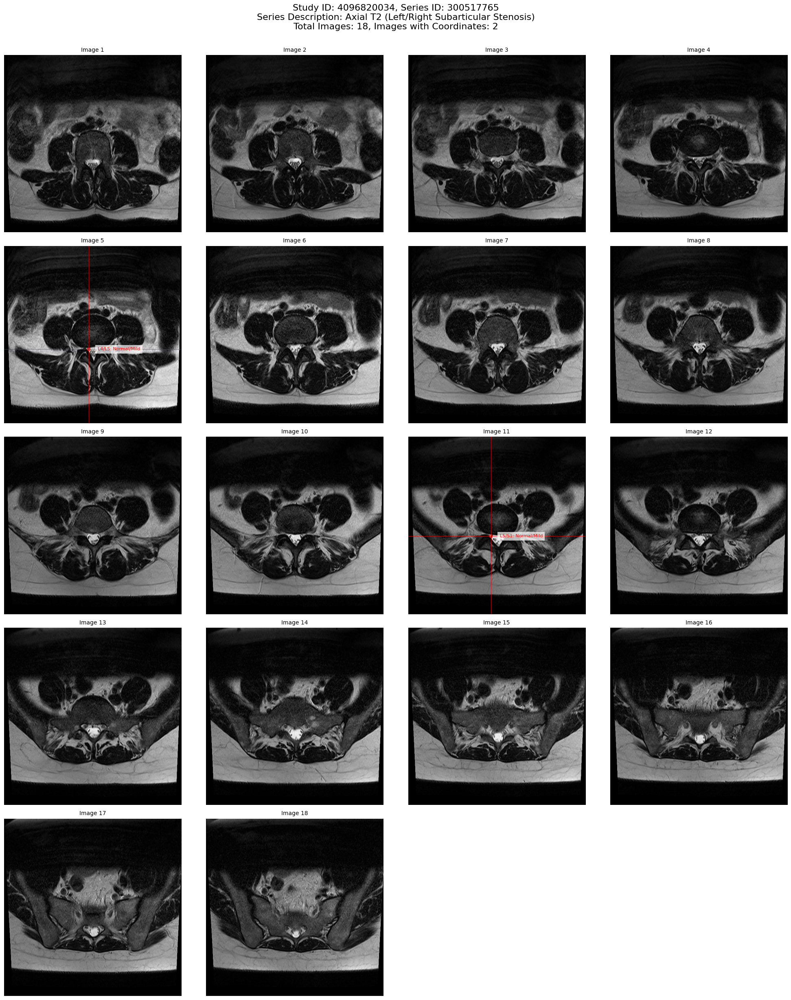

In [66]:
def display_series_grid_with_coordinates(study_id=None, series_id=None, images_per_row=4):
    series_info = get_study_series_info(study_id, series_id)
    study_id, series_id = series_info['study_id'], series_info['series_id']

    images = load_dcm_files(study_id, series_id)
    coords = get_coordinates(study_id, series_id)

    total_images = len(images)
    images_with_coords = coords['instance_number'].nunique()
    rows = (total_images + images_per_row - 1) // images_per_row

    # Determine the condition based on series description
    series_description = series_info['series_description']
    if 'Axial T2' in series_description:
        condition = 'Left/Right Subarticular Stenosis'
    elif 'Sagittal T1' in series_description:
        condition = 'Left/Right Neural Foraminal Narrowing'
    elif 'Sagittal T2/STIR' in series_description:
        condition = 'Spinal Canal Stenosis'
    else:
        condition = 'Unknown'

    # Get severity information from train_df
    study_data = train_df[train_df['study_id'] == study_id].iloc[0]

    fig = plt.figure(figsize=(5*images_per_row, 5*rows))
    title = fig.suptitle(f"Study ID: {study_id}, Series ID: {series_id}\n"
                         f"Series Description: {series_description} ({condition})\n"
                         f"Total Images: {total_images}, Images with Coordinates: {images_with_coords}",
                         fontsize=16)
    title.set_y(0.98)  # Adjust the position of the main title

    for i, image in enumerate(images, 1):
        ax = plt.subplot(rows, images_per_row, i)
        ax.imshow(image, cmap='gray')

        # Add crosshairs and circles for coordinates and severity information
        image_coords = coords[coords['instance_number'] == i]
        for _, coord in image_coords.iterrows():
            ax.axvline(x=coord['x'], color='r', linewidth=0.5)
            ax.axhline(y=coord['y'], color='r', linewidth=0.5)

            # Add red circle
            circle = Circle((coord['x'], coord['y']), 5, fill=False, ec='r')
            ax.add_patch(circle)

            # Determine severity based on condition and level
            level = coord['level'].lower().replace('/', '_')
            if condition == 'Spinal Canal Stenosis':
                col_name = f'spinal_canal_stenosis_{level}'
            elif condition == 'Left/Right Neural Foraminal Narrowing':
                side = coord['condition'].split()[0].lower()
                col_name = f'{side}_neural_foraminal_narrowing_{level}'
            elif condition == 'Left/Right Subarticular Stenosis':
                side = coord['condition'].split()[0].lower()
                col_name = f'{side}_subarticular_stenosis_{level}'
            else:
                col_name = None

            severity = study_data.get(col_name, 'Unknown') if col_name else 'Unknown'

            # Display severity to the right of the crosshair
            text_x = coord['x'] + image.shape[1] * 0.05  # 5% of image width to the right
            ax.text(text_x, coord['y'], f"{coord['level']}: {severity}", color='r', fontsize=8,
                    bbox=dict(facecolor='white', edgecolor='none', alpha=0.7),
                    verticalalignment='center')

        ax.set_title(f"Image {i}", fontsize=10)
        ax.axis('off')

    plt.tight_layout()
    plt.subplots_adjust(top=0.93)
    plt.show()

# display_series_grid_with_coordinates()
display_series_grid_with_coordinates(study_id=4096820034, series_id=300517765)

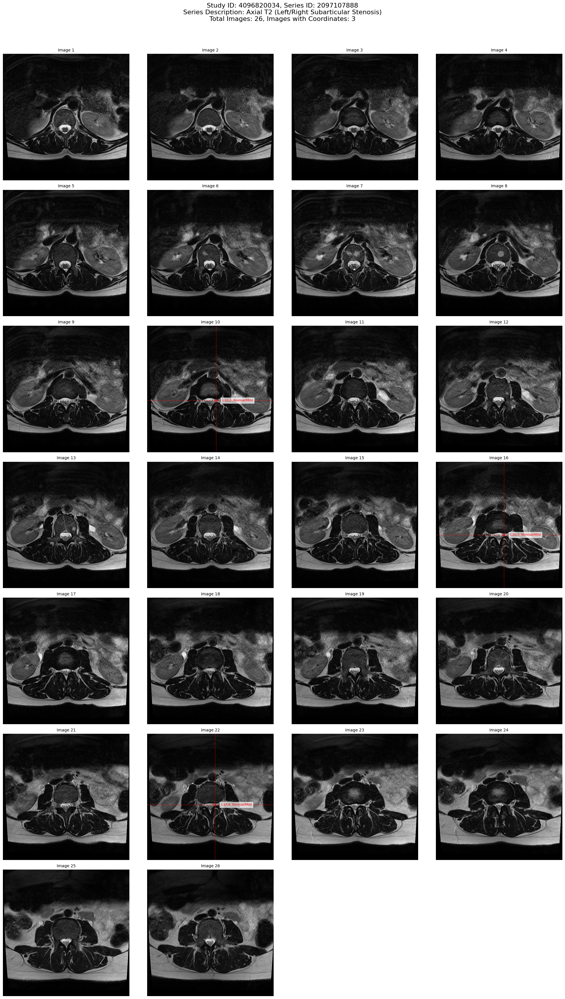

In [67]:
display_series_grid_with_coordinates(study_id=4096820034, series_id=2097107888)

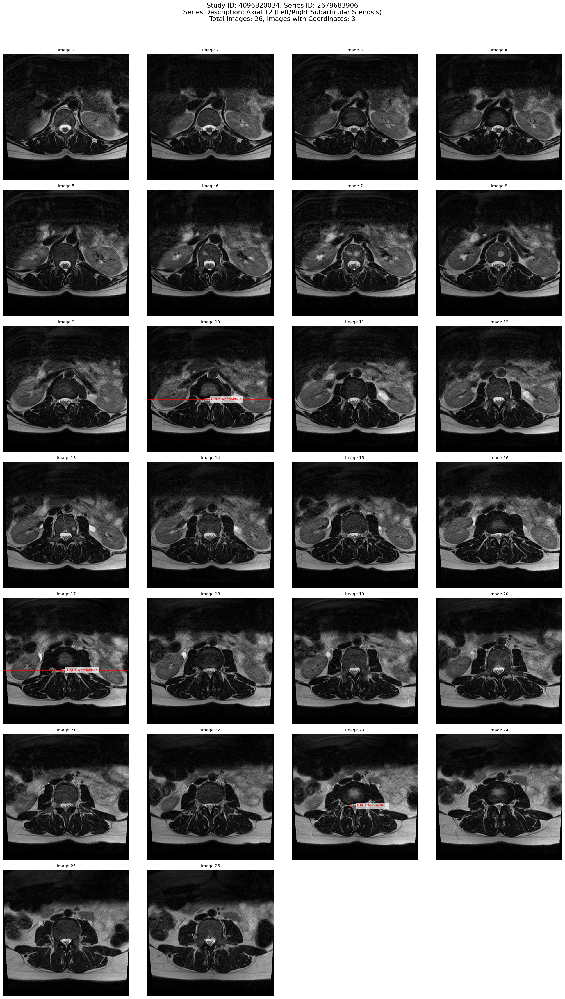

In [68]:
display_series_grid_with_coordinates(study_id=4096820034, series_id=2679683906)

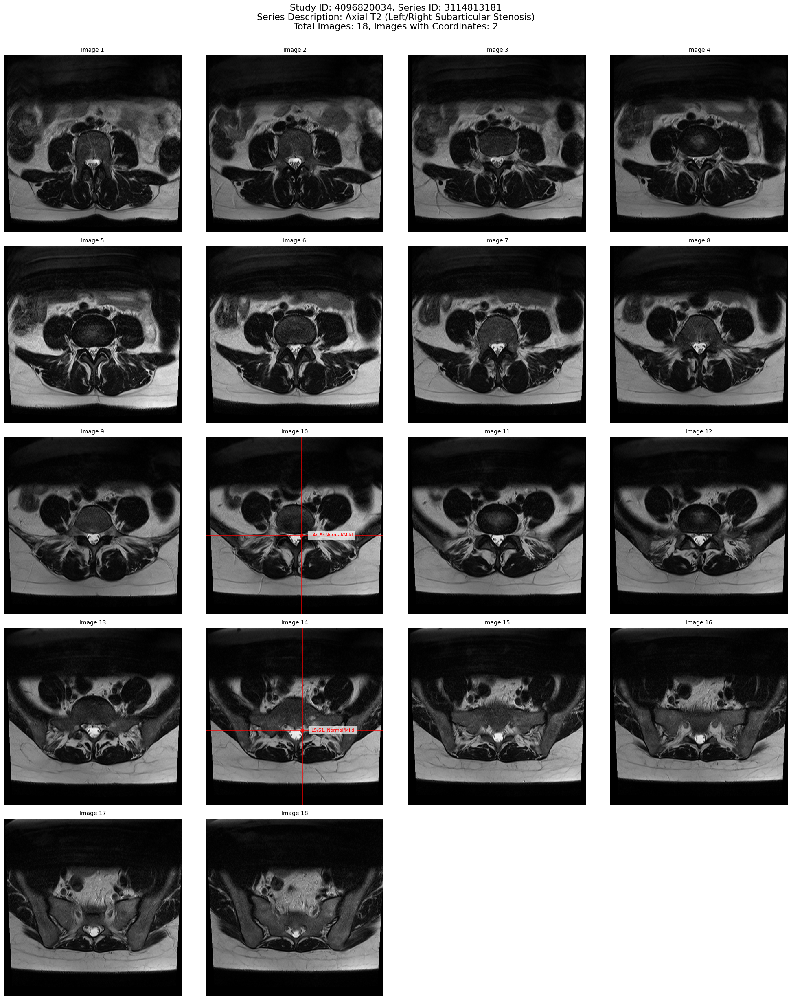

In [69]:
display_series_grid_with_coordinates(study_id=4096820034, series_id=3114813181)

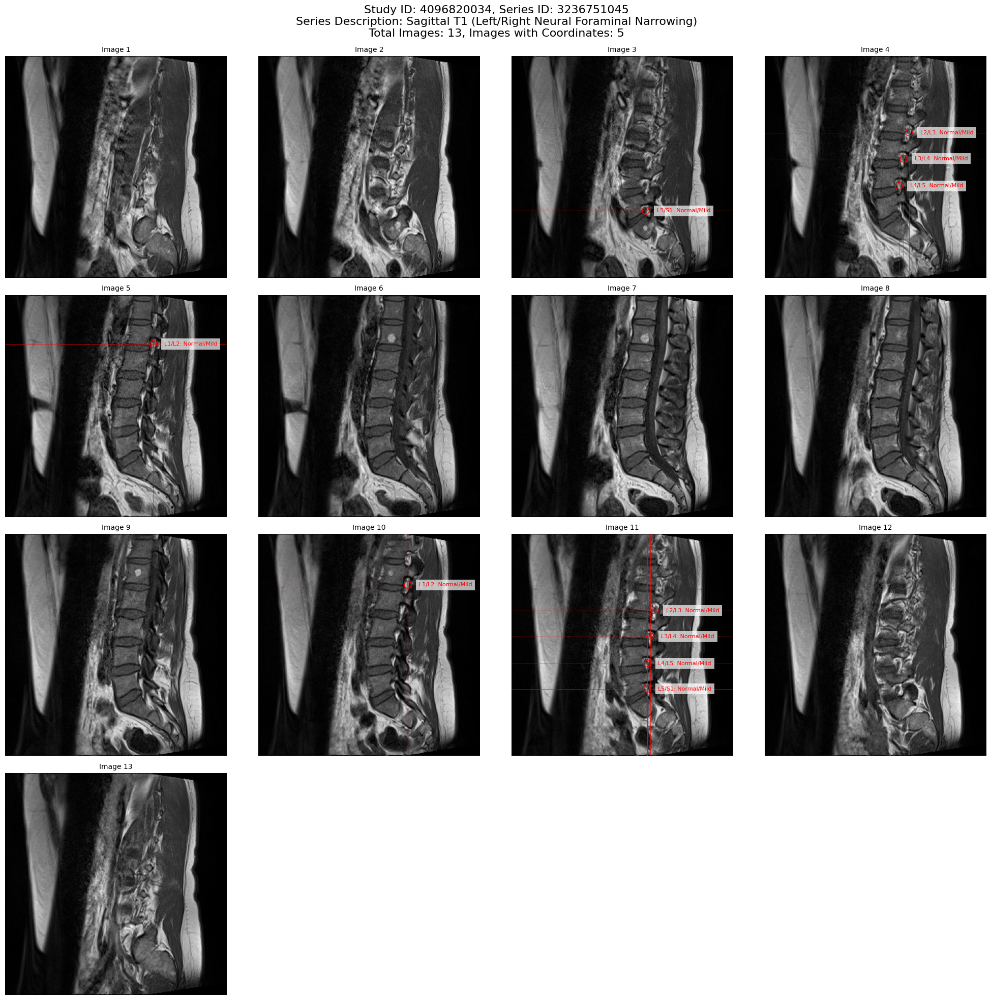

In [70]:
display_series_grid_with_coordinates(study_id=4096820034, series_id=3236751045)

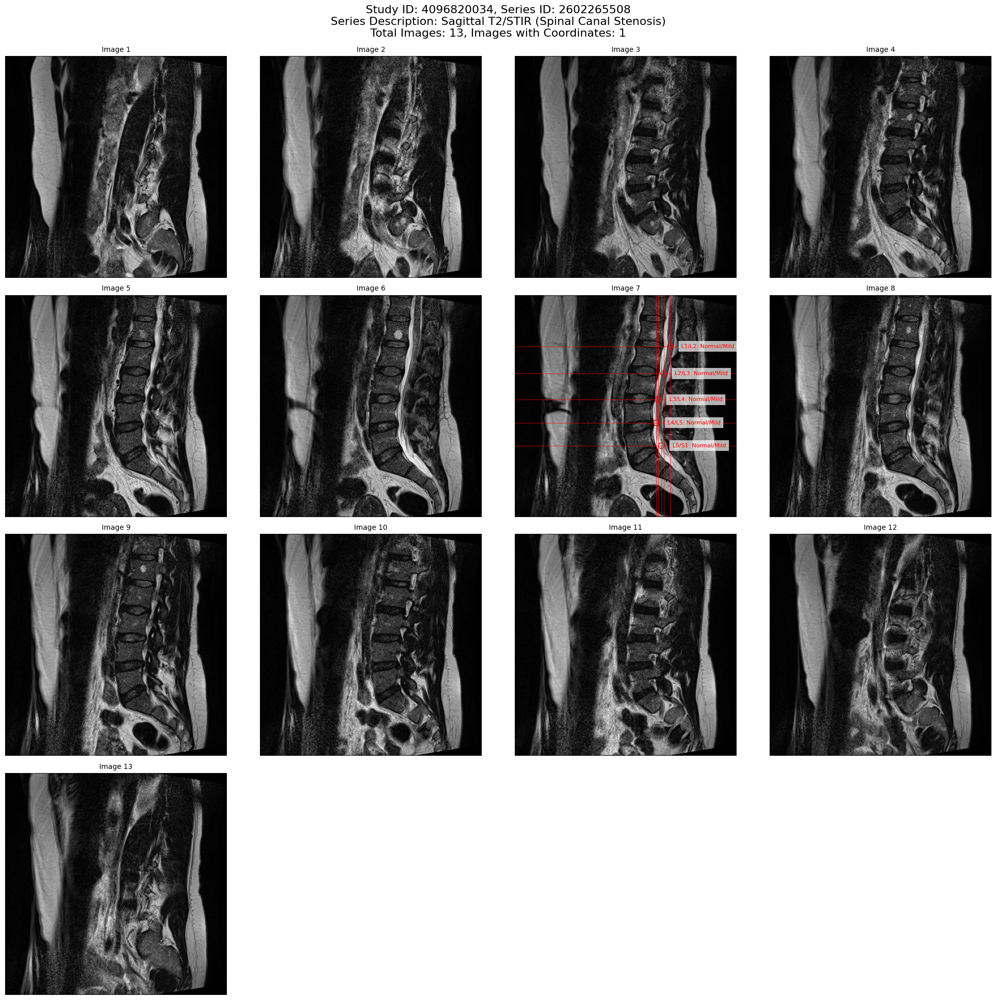

In [71]:
display_series_grid_with_coordinates(study_id=4096820034, series_id=2602265508)

In [72]:
# A2, S1, S2의 이미지 갯수 어떻게?

# S1, S2의 경우, 좌표 부여된 이미지는 다 넣어야.
# 좌표 표시된 이미지의 max 갯수 세어보자. --> 10, 5
# S1, S2의 경우, 시리즈가 2개 이상인 경우는 2개밖에 없음. 직접 예외처리하자.

# A2가 문제. 17%의 경우 시리즈가 2개 이상임. 주로 2개, 많으면 3, 4개.
# 2개 이상인 경우 위아래로 나뉘어져 있고, 시리즈 번호로 어디가 위인지 아래인지 알 수 있는 것도 아님.
# 3개 이상인 경우 중복이기도 함.
# --> 17%니까 일단 무시하고 제일 긴 거 하나만 쓰자.

# A2, S1, S2의 이미지 갯수를 정했지만 train 또는 test time에서 input channel 수보다 이미지가 부족하다면
# duplicate해서 채워넣을 수 있도록 예외처리하자.

In [73]:
def max_coordinated_images_for_sagittal_t1(desc_df, coord_df):
    # Create a dictionary for faster lookup in coord_df
    coord_dict = coord_df.groupby(['study_id', 'series_id'])['instance_number'].nunique().to_dict()

    max_count = 0
    max_study_series = None

    for _, row in desc_df.iterrows():
        study_id = row['study_id']
        series_id = row['series_id']
        series_description = row['series_description']

        if series_description == 'Sagittal T1':
            # Look up the count of unique instance numbers in coord_df
            count = coord_dict.get((study_id, series_id), 0)

            if count > max_count:
                max_count = count
                max_study_series = (study_id, series_id)

    return max_count, max_study_series

# Run the function
max_images, (max_study_id, max_series_id) = max_coordinated_images_for_sagittal_t1(desc_df, coord_df)

print(f"The maximum number of coordinated images for Sagittal T1 series is: {max_images}")
print(f"This occurs for Study ID: {max_study_id}, Series ID: {max_series_id}")

# Optional: Print the actual coordinates for this series
print("\nCoordinates for this series:")
max_series_coords = coord_df[(coord_df['study_id'] == max_study_id) &
                             (coord_df['series_id'] == max_series_id)]
print(max_series_coords[['instance_number', 'x', 'y', 'level', 'condition']])

The maximum number of coordinated images for Sagittal T1 series is: 10
This occurs for Study ID: 1755159626, Series ID: 2692914096

Coordinates for this series:
       instance_number           x           y  level  \
19669                4  293.992933  249.441696  L3/L4   
19670                6  286.756184  313.667845  L4/L5   
19671                7  294.897527  184.310954  L2/L3   
19672                8  292.183746  356.183746  L5/S1   
19673               10  300.325088  139.081272  L1/L2   
19674               11  295.314760  140.332266  L1/L2   
19675               12  266.137774  245.818293  L3/L4   
19676               13  272.870925  208.785964  L2/L3   
19677               15  272.309829  294.633635  L4/L5   
19678               17  285.776130  347.376649  L5/S1   

                              condition  
19669   Left Neural Foraminal Narrowing  
19670   Left Neural Foraminal Narrowing  
19671   Left Neural Foraminal Narrowing  
19672   Left Neural Foraminal Narrowing  
1

In [74]:
def max_coordinated_images_for_sagittal_t2_stir(desc_df, coord_df):
    # Create a dictionary for faster lookup in coord_df
    coord_dict = coord_df.groupby(['study_id', 'series_id'])['instance_number'].nunique().to_dict()

    max_count = 0
    max_study_series = None

    for _, row in desc_df.iterrows():
        study_id = row['study_id']
        series_id = row['series_id']
        series_description = row['series_description']

        if series_description == 'Sagittal T2/STIR':
            # Look up the count of unique instance numbers in coord_df
            count = coord_dict.get((study_id, series_id), 0)

            if count > max_count:
                max_count = count
                max_study_series = (study_id, series_id)

    return max_count, max_study_series

# Run the function
max_images, (max_study_id, max_series_id) = max_coordinated_images_for_sagittal_t2_stir(desc_df, coord_df)

print(f"The maximum number of coordinated images for Sagittal T2/STIR series is: {max_images}")
print(f"This occurs for Study ID: {max_study_id}, Series ID: {max_series_id}")

# Optional: Print the actual coordinates for this series
print("\nCoordinates for this series:")
max_series_coords = coord_df[(coord_df['study_id'] == max_study_id) &
                             (coord_df['series_id'] == max_series_id)]
print(max_series_coords[['instance_number', 'x', 'y', 'level', 'condition']])

The maximum number of coordinated images for Sagittal T2/STIR series is: 5
This occurs for Study ID: 1647904243, Series ID: 429524619

Coordinates for this series:
       instance_number           x           y  level              condition
18313                9  142.951754  168.842105  L5/S1  Spinal Canal Stenosis
18314               10  137.337719  137.964912  L4/L5  Spinal Canal Stenosis
18315               13  145.197368  111.017544  L3/L4  Spinal Canal Stenosis
18316               16  158.109649   83.508772  L2/L3  Spinal Canal Stenosis
18317               17  167.092105   55.438596  L1/L2  Spinal Canal Stenosis


In [78]:
def atoi(text):
    return int(text) if text.isdigit() else text

def natural_keys(text):
    return [atoi(c) for c in re.split(r'(\d+)', text)]

def convert_dcm_to_png(src_path, dst_path):
    dicom_data = pydicom.dcmread(src_path)
    image = dicom_data.pixel_array
    image = (image - image.min()) / (image.max() - image.min() + 1e-6) * 255
    img = cv2.resize(image, (512, 512), interpolation=cv2.INTER_CUBIC)
    assert img.shape == (512, 512)
    cv2.imwrite(dst_path, img)

In [ ]:
def process_sagittal_t1_series(desc_df, coord_df):
    source_path = f'{INPUT_PATH}/train_images'
    base_path = f'{OUTPUT_PATH}/cvt_png'

    total_studies = len(desc_df['study_id'].unique())
    
    for index, (study_id, study_group) in enumerate(desc_df.groupby('study_id'), 1):
        print(f"Processing study {study_id}")
        sagittal_t1_series = study_group[study_group['series_description'] == 'Sagittal T1']

        if sagittal_t1_series.empty:
            print(f"No Sagittal T1 series found for study {study_id}")
            continue

        print(f"Found {len(sagittal_t1_series)} Sagittal T1 series for study {study_id}")

        if len(sagittal_t1_series) > 1:
            matching_series = coord_df[coord_df['study_id'] == study_id].groupby('series_id')['instance_number'].nunique()
            print(f"Matching series in coord_df: {matching_series}")

            if not matching_series.empty:
                max_series_id = matching_series.idxmax()
                print(f"Selected series_id with most instances: {max_series_id}")
                matching_sagittal_t1 = sagittal_t1_series[sagittal_t1_series['series_id'] == max_series_id]
                if not matching_sagittal_t1.empty:
                    sagittal_t1_series = matching_sagittal_t1.iloc[0]
                else:
                    print(f"No matching Sagittal T1 series found in desc_df for series_id {max_series_id}")
                    sagittal_t1_series = sagittal_t1_series.iloc[0]
            else:
                print("No matching series found in coord_df, defaulting to first Sagittal T1 series")
                sagittal_t1_series = sagittal_t1_series.iloc[0]
        else:
            sagittal_t1_series = sagittal_t1_series.iloc[0]

        series_id = sagittal_t1_series['series_id']
        print(f"Selected series_id: {series_id}")

        # Create directories
        os.makedirs(f'{base_path}/{study_id}/Sagittal T1', exist_ok=True)

        # Get instance numbers from coord_df
        instance_numbers = coord_df[(coord_df['study_id'] == study_id) &
                                    (coord_df['series_id'] == series_id)]['instance_number'].unique()
        print(f"Found {len(instance_numbers)} instances for series {series_id}")

        # Get all .dcm files in the series folder
        series_folder = f'{source_path}/{study_id}/{series_id}'
        all_dcm_files = sorted([f for f in os.listdir(series_folder) if f.endswith('.dcm')], key=natural_keys)
        print(f"Found {len(all_dcm_files)} .dcm files in {series_folder}")

        # Select files
        selected_files = [f'{i}.dcm' for i in instance_numbers if f'{i}.dcm' in all_dcm_files]
        if len(selected_files) < 10:
            middle_index = len(all_dcm_files) // 2
            additional_files = all_dcm_files[middle_index - (10 - len(selected_files))//2 :
                                             middle_index + (10 - len(selected_files) + 1)//2]
            selected_files.extend([f for f in additional_files if f not in selected_files])

        # Ensure we have exactly 10 files
        selected_files = (selected_files * ((10 + len(selected_files) - 1) // len(selected_files)))[:10]
        print(f"Selected {len(selected_files)} files for conversion")

        # Convert selected files to PNG
        for i, dcm_file in enumerate(selected_files, 1):
            src_path = f'{series_folder}/{dcm_file}'
            dst_path = f'{base_path}/{study_id}/Sagittal T1/{i:02d}.png'
            convert_dcm_to_png(src_path, dst_path)

        progress_percentage = (index / total_studies) * 100
        print(f"Processed study {study_id}, series {series_id}")
        print(f"Progress: {progress_percentage:.2f}% complete")
        print("-------------------")

# Run the function
process_sagittal_t1_series(desc_df, coord_df)

In [ ]:
def process_sagittal_t2_stir_series(desc_df, coord_df):
    source_path = f'{INPUT_PATH}/train_images'
    base_path = f'{OUTPUT_PATH}/cvt_png'

    total_studies = len(desc_df['study_id'].unique())
    
    for index, (study_id, study_group) in enumerate(desc_df.groupby('study_id'), 1):
        print(f"Processing study {study_id}")
        sagittal_t2_stir_series = study_group[study_group['series_description'] == 'Sagittal T2/STIR']

        if sagittal_t2_stir_series.empty:
            print(f"No Sagittal T2/STIR series found for study {study_id}")
            continue

        print(f"Found {len(sagittal_t2_stir_series)} Sagittal T2/STIR series for study {study_id}")

        if len(sagittal_t2_stir_series) > 1:
            matching_series = coord_df[coord_df['study_id'] == study_id].groupby('series_id')['instance_number'].nunique()
            print(f"Matching series in coord_df: {matching_series}")

            if not matching_series.empty:
                max_series_id = matching_series.idxmax()
                print(f"Selected series_id with most instances: {max_series_id}")
                matching_sagittal_t2_stir = sagittal_t2_stir_series[sagittal_t2_stir_series['series_id'] == max_series_id]
                if not matching_sagittal_t2_stir.empty:
                    sagittal_t2_stir_series = matching_sagittal_t2_stir.iloc[0]
                else:
                    print(f"No matching Sagittal T2/STIR series found in desc_df for series_id {max_series_id}")
                    sagittal_t2_stir_series = sagittal_t2_stir_series.iloc[0]
            else:
                print("No matching series found in coord_df, defaulting to first Sagittal T2/STIR series")
                sagittal_t2_stir_series = sagittal_t2_stir_series.iloc[0]
        else:
            sagittal_t2_stir_series = sagittal_t2_stir_series.iloc[0]

        series_id = sagittal_t2_stir_series['series_id']
        print(f"Selected series_id: {series_id}")

        # Create directories
        os.makedirs(f'{base_path}/{study_id}/Sagittal T2_STIR', exist_ok=True)

        # Get instance numbers from coord_df
        instance_numbers = coord_df[(coord_df['study_id'] == study_id) &
                                    (coord_df['series_id'] == series_id)]['instance_number'].unique()
        print(f"Found {len(instance_numbers)} instances for series {series_id}")

        # Get all .dcm files in the series folder
        series_folder = f'{source_path}/{study_id}/{series_id}'
        all_dcm_files = sorted([f for f in os.listdir(series_folder) if f.endswith('.dcm')], key=natural_keys)
        print(f"Found {len(all_dcm_files)} .dcm files in {series_folder}")

        # Select files
        selected_files = [f'{i}.dcm' for i in instance_numbers if f'{i}.dcm' in all_dcm_files]
        if len(selected_files) < 10:
            middle_index = len(all_dcm_files) // 2
            additional_files = all_dcm_files[middle_index - (10 - len(selected_files))//2 :
                                             middle_index + (10 - len(selected_files) + 1)//2]
            selected_files.extend([f for f in additional_files if f not in selected_files])

        # Ensure we have exactly 10 files
        selected_files = (selected_files * ((10 + len(selected_files) - 1) // len(selected_files)))[:10]
        print(f"Selected {len(selected_files)} files for conversion")

        # Convert selected files to PNG
        for i, dcm_file in enumerate(selected_files, 1):
            src_path = f'{series_folder}/{dcm_file}'
            dst_path = f'{base_path}/{study_id}/Sagittal T2_STIR/{i:02d}.png'
            convert_dcm_to_png(src_path, dst_path)

        progress_percentage = (index / total_studies) * 100
        print(f"Processed study {study_id}, series {series_id}")
        print(f"Progress: {progress_percentage:.2f}% complete")
        print("-------------------")

# Run the function
process_sagittal_t2_stir_series(desc_df, coord_df)

In [ ]:
def process_axial_t2_series(desc_df, coord_df):
    source_path = f'{INPUT_PATH}/train_images'
    base_path = f'{OUTPUT_PATH}/cvt_png'

    total_studies = len(desc_df['study_id'].unique())
    
    for index, (study_id, study_group) in enumerate(desc_df.groupby('study_id'), 1):
        print(f"Processing study {study_id}")
        axial_t2_series = study_group[study_group['series_description'] == 'Axial T2']

        if axial_t2_series.empty:
            print(f"No Axial T2 series found for study {study_id}")
            continue

        print(f"Found {len(axial_t2_series)} Axial T2 series for study {study_id}")

        if len(axial_t2_series) > 1:
            matching_series = coord_df[coord_df['study_id'] == study_id].groupby('series_id')['instance_number'].nunique()
            print(f"Matching series in coord_df: {matching_series}")

            if not matching_series.empty:
                max_series_id = matching_series.idxmax()
                print(f"Selected series_id with most instances: {max_series_id}")
                matching_axial_t2 = axial_t2_series[axial_t2_series['series_id'] == max_series_id]
                if not matching_axial_t2.empty:
                    axial_t2_series = matching_axial_t2.iloc[0]
                else:
                    print(f"No matching Axial T2 series found in desc_df for series_id {max_series_id}")
                    axial_t2_series = axial_t2_series.iloc[0]
            else:
                print("No matching series found in coord_df, defaulting to first Axial T2 series")
                axial_t2_series = axial_t2_series.iloc[0]
        else:
            axial_t2_series = axial_t2_series.iloc[0]

        series_id = axial_t2_series['series_id']
        print(f"Selected series_id: {series_id}")

        # Create directories
        os.makedirs(f'{base_path}/{study_id}/Axial T2', exist_ok=True)

        # Get instance numbers from coord_df
        instance_numbers = coord_df[(coord_df['study_id'] == study_id) &
                                    (coord_df['series_id'] == series_id)]['instance_number'].unique()
        print(f"Found {len(instance_numbers)} instances for series {series_id}")

        # Get all .dcm files in the series folder
        series_folder = f'{source_path}/{study_id}/{series_id}'
        all_dcm_files = sorted([f for f in os.listdir(series_folder) if f.endswith('.dcm')], key=natural_keys)
        print(f"Found {len(all_dcm_files)} .dcm files in {series_folder}")

        # Select files
        if len(all_dcm_files) >= 20:
            # Select 20 files with equal distance
            selected_indices = np.linspace(0, len(all_dcm_files) - 1, 20, dtype=int)
            selected_files = [all_dcm_files[i] for i in selected_indices]
        else:
            # If less than 20 files, use all and then duplicate
            selected_files = all_dcm_files.copy()
            while len(selected_files) < 20:
                for file in all_dcm_files:
                    if len(selected_files) < 20:
                        selected_files.append(file)
                    else:
                        break

        print(f"Selected {len(selected_files)} files for conversion")

        # Convert selected files to PNG
        for i, dcm_file in enumerate(selected_files, 1):
            src_path = f'{series_folder}/{dcm_file}'
            dst_path = f'{base_path}/{study_id}/Axial T2/{i:02d}.png'
            convert_dcm_to_png(src_path, dst_path)

        progress_percentage = (index / total_studies) * 100
        print(f"Processed study {study_id}, series {series_id}")
        print(f"Progress: {progress_percentage:.2f}% complete")
        print("-------------------")

# Run the function
process_axial_t2_series(desc_df, coord_df)

In [82]:
def check_converted_files(output_path):
    cvt_png_path = f'{output_path}/cvt_png'
    
    # Check if the directory exists
    if not os.path.exists(cvt_png_path):
        print(f"The directory {cvt_png_path} does not exist.")
        return

    # Get all folders in cvt_png
    study_folders = [f for f in os.listdir(cvt_png_path) if os.path.isdir(os.path.join(cvt_png_path, f))]
    
    print(f"Number of folders inside cvt_png: {len(study_folders)}")

    incomplete_axial_t2 = []
    incomplete_sagittal_t1 = []
    incomplete_sagittal_t2_stir = []
    missing_folders = []

    for study_folder in study_folders:
        study_path = os.path.join(cvt_png_path, study_folder)
        
        # Check for the presence of all three folders
        axial_t2_path = os.path.join(study_path, 'Axial T2')
        sagittal_t1_path = os.path.join(study_path, 'Sagittal T1')
        sagittal_t2_stir_path = os.path.join(study_path, 'Sagittal T2_STIR')
        
        if not all(os.path.exists(path) for path in [axial_t2_path, sagittal_t1_path, sagittal_t2_stir_path]):
            missing_folders.append(study_folder)
            continue

        # Check Axial T2
        axial_t2_files = [f for f in os.listdir(axial_t2_path) if f.endswith('.png')]
        if len(axial_t2_files) != 20:
            incomplete_axial_t2.append(study_folder)

        # Check Sagittal T1
        sagittal_t1_files = [f for f in os.listdir(sagittal_t1_path) if f.endswith('.png')]
        if len(sagittal_t1_files) != 10:
            incomplete_sagittal_t1.append(study_folder)

        # Check Sagittal T2_STIR
        sagittal_t2_stir_files = [f for f in os.listdir(sagittal_t2_stir_path) if f.endswith('.png')]
        if len(sagittal_t2_stir_files) != 10:
            incomplete_sagittal_t2_stir.append(study_folder)

    print("\nResults:")
    print(f"Studies missing one or more folders: {len(missing_folders)}")
    print(f"Studies with incorrect number of Axial T2 images: {len(incomplete_axial_t2)}")
    print(f"Studies with incorrect number of Sagittal T1 images: {len(incomplete_sagittal_t1)}")
    print(f"Studies with incorrect number of Sagittal T2/STIR images: {len(incomplete_sagittal_t2_stir)}")

    total_incomplete = len(set(missing_folders + incomplete_axial_t2 + incomplete_sagittal_t1 + incomplete_sagittal_t2_stir))
    print(f"\nTotal number of studies with issues: {total_incomplete}")

# Run the function
check_converted_files(OUTPUT_PATH)

Number of folders inside cvt_png: 1975

Results:
Studies missing one or more folders: 3
Studies with incorrect number of Axial T2 images: 0
Studies with incorrect number of Sagittal T1 images: 0
Studies with incorrect number of Sagittal T2/STIR images: 0

Total number of studies with issues: 3


In [83]:
def check_and_clean_converted_files(output_path):
    cvt_png_path = f'{output_path}/cvt_png'
    
    if not os.path.exists(cvt_png_path):
        print(f"The directory {cvt_png_path} does not exist.")
        return

    study_folders = [f for f in os.listdir(cvt_png_path) if os.path.isdir(os.path.join(cvt_png_path, f))]
    print(f"Initial number of study folders: {len(study_folders)}")

    studies_to_delete = set()

    for study_folder in study_folders:
        study_path = os.path.join(cvt_png_path, study_folder)
        
        axial_t2_path = os.path.join(study_path, 'Axial T2')
        sagittal_t1_path = os.path.join(study_path, 'Sagittal T1')
        sagittal_t2_stir_path = os.path.join(study_path, 'Sagittal T2_STIR')
        
        # Check for missing folders
        if not all(os.path.exists(path) for path in [axial_t2_path, sagittal_t1_path, sagittal_t2_stir_path]):
            studies_to_delete.add(study_folder)
            continue

        # Check number of PNG files in each folder
        if len([f for f in os.listdir(axial_t2_path) if f.endswith('.png')]) != 20:
            studies_to_delete.add(study_folder)
        elif len([f for f in os.listdir(sagittal_t1_path) if f.endswith('.png')]) != 10:
            studies_to_delete.add(study_folder)
        elif len([f for f in os.listdir(sagittal_t2_stir_path) if f.endswith('.png')]) != 10:
            studies_to_delete.add(study_folder)

    # Delete studies with issues
    for study_to_delete in studies_to_delete:
        study_path = os.path.join(cvt_png_path, study_to_delete)
        shutil.rmtree(study_path)
        print(f"Deleted study folder: {study_to_delete}")

    # Count remaining study folders
    remaining_studies = [f for f in os.listdir(cvt_png_path) if os.path.isdir(os.path.join(cvt_png_path, f))]
    
    print(f"\nNumber of studies deleted: {len(studies_to_delete)}")
    print(f"Total number of remaining study folders: {len(remaining_studies)}")

# Run the function
check_and_clean_converted_files(OUTPUT_PATH)

Initial number of study folders: 1975
Deleted study folder: 3008676218
Deleted study folder: 2780132468
Deleted study folder: 2492114990

Number of studies deleted: 3
Total number of remaining study folders: 1972
